In [2]:
import pandas as pd
import geopandas as gpd
import momepy as mm
import numpy as np
import pyproj
from scipy.spatial.distance import cdist

import matplotlib.pyplot as plt
import osmnx
import prettymaps
import libpysal
import utm
import matplotlib
from shapely.geometry import box
import missingno as msno

from shapely import geometry
import matplotlib
from scipy.spatial import cKDTree
from time import time
from pyproj import CRS
from shapely.geometry import Polygon, Point, MultiPolygon
import seaborn as sns
from scipy.stats import entropy
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix
from sklearn import metrics

from tqdm import tqdm
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, classification_report

# Import and clean the raw datasets

In [4]:
# cities dataset
df = pd.read_csv("worldcities.csv")

df = df[(df['population'] > 10000) | pd.isna(df['population'])] #keep only rows where the column population is higher than 10,000 or unknown
geometry = [Point(xy) for xy in zip(df['lng'], df['lat'])] # transform coordinates to spatial data
gdf = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")

# Cities' classification into cultural spheres
cultural_class = gpd.read_file("merged_countries.geojson", crs="EPSG:4326")
cities = gpd.sjoin(gdf, cultural_class, how="left", predicate="within")

# Impute missing classifications based on nearest city's class
missing_classification_cities = cities[cities['Classification'].isnull()] # Find cities with missing classification
cities_with_classification = cities.dropna(subset=['Classification']) # Save cities without missing classification
tree = cKDTree(cities_with_classification['geometry'].apply(lambda point: (point.x, point.y)).tolist())
def find_nearest_classification(point):
    _, idx = tree.query((point.x, point.y))
    return cities_with_classification.iloc[idx]['Classification']

# Assign the same classification to cities with missing values in the original cities GeoDataFrame
cities.loc[missing_classification_cities.index, 'Classification'] = missing_classification_cities['geometry'].apply(find_nearest_classification)
cities = cities.drop(columns='index_right')

# Cities' classification into continents
world_continents = gpd.read_file("/World_Continents.geojson", crs="EPSG:4326")
cities = gpd.sjoin(cities, world_continents, how="left", predicate="within")

# Megre Australia into Oceania
cities['CONTINENT'] = cities['CONTINENT'].replace('Australia', 'Oceania')
cities['CONTINENT'] = cities['CONTINENT'].replace('Antarctica', 'South America')

# Kepp only the first 2000 largest cities on each continent
num_cit_per_cont=2000
cities = pd.concat([cities[cities['CONTINENT'] == 'Asia'].head(num_cit_per_cont), cities[cities['CONTINENT'] != 'Asia']])
cities = pd.concat([cities[cities['CONTINENT'] == 'Europe'].head(num_cit_per_cont), cities[cities['CONTINENT'] != 'Europe']])
cities = pd.concat([cities[cities['CONTINENT'] == 'North America'].head(num_cit_per_cont), cities[cities['CONTINENT'] != 'North America']])
cities = pd.concat([cities[cities['CONTINENT'] == 'Africa'].head(num_cit_per_cont), cities[cities['CONTINENT'] != 'Africa']])
cities = pd.concat([cities[cities['CONTINENT'] == 'South America'].head(num_cit_per_cont), cities[cities['CONTINENT'] != 'South America']])

cities.reset_index(inplace=True)

# keep only relevant columns
cities = cities.drop(columns=['index','index_right','FID','SQMI','SQKM','Shape__Area','Shape__Length','SHAPE_Length','SHAPE_Area','COUNTRY','ISO'])

In [5]:
# check number of cities per continent
cities_per_continent = cities['CONTINENT'].value_counts()

print("Number of cities per continent:")
print(cities_per_continent)

Number of cities per continent:
South America    2000
Africa           2000
North America    2000
Europe           2000
Asia             2000
Oceania           215
Name: CONTINENT, dtype: int64


# Downloading Urban Morphometrics data
Divide into seperate datsets for lower memory needs when dowloading OSM data

In [6]:
grouped_df = cities.groupby('CONTINENT')
continent_datasets = {}
for continent, group in grouped_df:
    continent_datasets[continent] = group

asia_cities = continent_datasets['Asia']
europe_cities = continent_datasets['Europe']
africa_cities = continent_datasets['Africa']
namerica_cities = continent_datasets['North America']
samerica_cities = continent_datasets['South America']
oceania_cities = continent_datasets['Oceania']

In [7]:
# define function that adds urban morphometrics columns to the original dataset
def add_mm(dataset, dist):
    dataset.reset_index(inplace=True)

    for index, row in dataset.iterrows():
        try:
            city_coordinates = tuple([row['lat'], row['lng']])
            city_name = row['city_ascii']
            country_name = row['country']
            continentlabel = row['CONTINENT']
            print(f"Doing {city_name}: {index+1}/{len(dataset)}")

            try:
                buildings = osmnx.features.features_from_point(city_coordinates, dist=dist, tags={'building':True})

                # Transform Polygons into Multipolygons for intersection
                buildings['geometry'] = buildings['geometry'].buffer(0)
                buildings['geometry'] = buildings['geometry'].apply(lambda geom: MultiPolygon([geom]) if geom.is_empty or geom.is_ring else geom)

                # boundingx box for clipping the buildings
                lat, lon = city_coordinates[0], city_coordinates[1]
                minx = lon - (dist / (111.32 * 1000))
                maxx = lon + (dist / (111.32 * 1000))
                miny = lat - (dist / (111.32 * 1000))
                maxy = lat + (dist / (111.32 * 1000))

                bounding_box = Polygon([(minx, miny), (minx, maxy), (maxx, maxy), (maxx, miny)])
                bbox = gpd.GeoDataFrame({'geometry': [bounding_box]}, crs='EPSG:4326')
                bbox = bbox.to_crs('EPSG:4326')

                clipped_buildings = gpd.overlay(buildings, bbox, how="intersection")
                clipped_buildings.to_crs('EPSG:4326')
                clipped_buildings_area = clipped_buildings.area.sum()
                prop_building_area = clipped_buildings_area / bbox.area.sum()

                # Only keeping cities where the proportion of total area of buildings is greater than 7% of the bounding box
                # This is a simplistic approach at skipping cities where OSM doesn't have much data
                if prop_building_area > 0.07:

                    buildings = osmnx.projection.project_gdf(buildings)
                    buildings = buildings[buildings.geom_type.isin(['Polygon', 'MultiPolygon'])]
                    buildings = buildings.reset_index(drop=True).explode(index_parts=True).reset_index(drop=True)
                    buildings = buildings[["geometry"]]

                    streets_graph = osmnx.graph_from_point(city_coordinates, dist=dist+200, network_type='drive')
                    streets_graph = osmnx.get_undirected(streets_graph)
                    streets_graph = osmnx.projection.project_graph(streets_graph)
                    streets = osmnx.graph_to_gdfs(streets_graph, nodes=False, edges=True, node_geometry=False, fill_edge_geometry=True)
                    streets = streets[["geometry"]]

                    assert buildings.crs.equals(streets.crs)

                    buildings['uID'] = range(len(buildings))
                    tessellation = mm.Tessellation(buildings, "uID", limit=box(*buildings.total_bounds), verbose=False).tessellation
                    tessellation['cell_area'] = tessellation.area

                    car_md = mm.AreaRatio(tessellation, buildings, "cell_area", buildings.area, "uID").series.median()
                    car_std = mm.AreaRatio(tessellation, buildings, "cell_area", buildings.area, "uID").series.std()

                    streetlen_md = streets.length.median()
                    streetlen_std = streets.length.std()

                    streetlin_md = mm.Linearity(streets).series.median()
                    streetlin_std = mm.Linearity(streets).series.std()

                    try:
                        profile = mm.StreetProfile(streets, buildings, distance=3)
                        street_width_md = profile.w.median()
                        street_width_std = profile.w.std()

                        street_width_deviation_md = profile.wd.median()
                        street_width_deviation_std = profile.wd.std()

                        street_openness_md = profile.o.median()
                        street_openness_std = profile.o.std()

                        buildings_wall_md = mm.PerimeterWall(buildings, verbose=False).series.median()
                        buildings_wall_std = mm.PerimeterWall(buildings, verbose=False).series.std()

                        # weight matrix based on contiguity for building adjecency
                        W1 = libpysal.weights.Queen.from_dataframe(tessellation, ids="uID", use_index=False)
                        W3 = mm.sw_high(k=3, weights=W1)

                        buildings_adjacency_md = mm.BuildingAdjacency(buildings, W3, "uID", verbose=False).series.median()
                        buildings_adjacency_std = mm.BuildingAdjacency(buildings, W3, "uID", verbose=False).series.std()

                        buildings_neighbour_distance_md = mm.NeighborDistance(buildings, W1, 'uID', verbose=False).series.median()
                        buildings_neighbour_distance_std = mm.NeighborDistance(buildings, W1, 'uID', verbose=False).series.std()

                    except ValueError as e:
                        print(f"Error for {city_name}: {e}")
                        profile = None
                        car_md = None
                        car_std = None
                        streetlen_md = None
                        streetlen_std = None
                        streetlin_md = None
                        streetlin_std = None
                        street_width_md = None
                        street_width_std = None
                        street_width_deviation_md = None
                        street_width_deviation_std = None
                        street_openness_md = None
                        street_openness_std = None
                        buildings_wall_md = None
                        buildings_wall_std = None
                        buildings_adjacency_md = None
                        buildings_adjacency_std = None
                        buildings_neighbour_distance_md = None
                        buildings_neighbour_distance_std = None
                else:
                  print(f"Area of buildings too small for {city_name}, {country_name}: {prop_building_area}")

            except Exception as e:
                    print(f"Insufficient response for streets in {city_name}, {country_name}. Skipping... The error: {e}")
                    profile = None
                    car_md = None
                    car_std = None
                    streetlen_md = None
                    streetlen_std = None
                    streetlin_md = None
                    streetlin_std = None
                    street_width_md = None
                    street_width_std = None
                    street_width_deviation_md = None
                    street_width_deviation_std = None
                    street_openness_md = None
                    street_openness_std = None
                    buildings_wall_md = None
                    buildings_wall_std = None
                    buildings_adjacency_md = None
                    buildings_adjacency_std = None
                    buildings_neighbour_distance_md = None
                    buildings_neighbour_distance_std = None

            dataset.loc[index, "tessellation_car_md"] = car_md
            dataset.loc[index, "tessellation_car_std"] = car_std
            dataset.loc[index, "streetlen_md"] = streetlen_md
            dataset.loc[index, "streetlen_std"] = streetlen_std
            dataset.loc[index, "streetlin_md"] = streetlin_md
            dataset.loc[index, "streetlin_std"] = streetlin_std
            dataset.loc[index, "street_width_md"] = street_width_md
            dataset.loc[index, "street_width_std"] = street_width_std
            dataset.loc[index, "street_width_deviation_md"] = street_width_deviation_md
            dataset.loc[index, "street_width_deviation_std"] = street_width_deviation_std
            dataset.loc[index, "street_openness_md"] = street_openness_md
            dataset.loc[index, "street_openness_std"] = street_openness_std
            dataset.loc[index, "buildings_wall_md"]=buildings_wall_md
            dataset.loc[index, "buildings_wall_std"]=buildings_wall_std
            dataset.loc[index, "buildings_adjacency_md"] = buildings_adjacency_md
            dataset.loc[index, "buildings_adjacency_std"] = buildings_adjacency_std
            dataset.loc[index, "buildings_neighbour_distance_md"] = buildings_neighbour_distance_md
            dataset.loc[index, "buildings_neighbour_distance_std"] = buildings_neighbour_distance_std

        except Exception as ex:
            print(f"An error occurred in iteration {index} for city {city_name}, {country_name}: {ex}")

        if (index + 1) % 50 == 0:
            # Save the dataset to a file
            file_name = f'/downloaded_morphometrics/renewed/NEW_{continentlabel}_d800.csv'
            dataset.to_csv(file_name, index=False)
            print(f"Dataset saved to {file_name} after {index+1} cities")

    return dataset

In [8]:
load_data = True  # Set this to False if you want to download the data

if load_data:
    oceania_cities = pd.read_csv('data/downloaded_morphometrics/oceania_d800.csv')
    asia_cities = pd.read_csv('data/downloaded_morphometrics/asia_d800.csv')
    europe_cities = pd.read_csv('/downloaded_morphometrics/europe_d800.csv')
    africa_cities = pd.read_csv('/downloaded_morphometrics/africa_d800.csv')
    namerica_cities = pd.read_csv('/downloaded_morphometrics/namerica_d800.csv')
    samerica_cities = pd.read_csv('/downloaded_morphometrics/samerica_d800.csv')
    cities_mm = pd.concat([oceania_cities, asia_cities, europe_cities, africa_cities, namerica_cities, samerica_cities], ignore_index=True)
    cities_mm = cities_mm.drop(columns=['index','city','city_ascii','lat','lng','country','iso2','iso3','admin_name','capital','population'])
    cities = pd.merge(cities, cities_mm, on='id', how='right')

else:

    oceania_cities = add_mm(oceania_cities, dist=800)

    oceania_cities.to_csv('/downloaded_morphometrics/oceania_d800.csv', index=False)
    files.download('/downloaded_morphometrics/oceania_d800.csv')

    asia_cities = add_mm(asia_cities, dist=800)
    europe_cities = add_mm(europe_cities, dist=800)
    africa_cities = add_mm(africa_cities, dist=800)
    namerica_cities = add_mm(namerica_cities, dist=800)
    samerica_cities = add_mm(samerica_cities, dist=800)

    samerica_cities.to_csv('/downloaded_morphometrics/samerica_d800.csv', index=False)
    files.download('/downloaded_morphometrics/samerica_d800.csv')

    africa_cities.to_csv('/downloaded_morphometrics/africa_d800.csv', index=False)
    files.download('/downloaded_morphometrics/africa_d800.csv')

    europe_cities.to_csv('/downloaded_morphometrics/europe_d800.csv', index=False)
    files.download('/downloaded_morphometrics/europe_d800.csv')

    namerica_cities.to_csv('/downloaded_morphometrics/namerica_d800.csv', index=False)
    files.download('/downloaded_morphometrics/namerica_d800.csv')

    asia_cities.to_csv('/downloaded_morphometrics/asia_d800.csv', index=False)
    files.download('/downloaded_morphometrics/asia_d800.csv')

    cities_mm = pd.concat([oceania_cities, asia_cities, europe_cities, africa_cities, namerica_cities, samerica_cities], ignore_index=True)
    cities_mm = cities_mm.drop(columns=['index','city','city_ascii','lat','lng','country','iso2','iso3','admin_name','capital','population'])
    cities = pd.merge(cities, cities_mm, on='id', how='right')

## Downloading land use data from OSM
Not used in the analysis in the end

In [9]:
# Define the list of key-value pairs
tags_list = [
    {"landuse": "residential"},
    {"landuse": "commercial"},
    {"landuse": "industrial"},
    {"landuse": "retail"},
    {"landuse": "institutional"},
    {"landuse": "farmland"},
    {"landuse": "farmyard"},
    {"landuse": "forest"},
    {"landuse": "port"},
    {"landuse": "recreation_ground"},
    {"landuse": "religious"},
    {"leisure": "park"},
    {"natural":"water"}
]

if load_data:
    df = pd.read_csv("/OSM_landuse_cities.csv")
    df.fillna(0, inplace=True)
    geometry = [Point(xy) for xy in zip(df['lng'], df['lat'])]
    gdf = gpd.GeoDataFrame(df, geometry=geometry)

else:
    # Loop through the list and call geometries_from_point for each tag
    for index, row in cities.iterrows():
        city_coordinates = tuple([row['lat'], row['lng']])
        city_name = row['city']

        radius = 1000
        lat, lon = city_coordinates[0], city_coordinates[1]
        target_crs = 'EPSG:4326'  # Replace with your desired CRS, e.g., EPSG code

        minx = lon - (radius / (111.32 * 1000))  # Longitude calculation for the west edge
        maxx = lon + (radius / (111.32 * 1000))  # Longitude calculation for the east edge
        miny = lat - (radius / (111.32 * 1000))  # Latitude calculation for the south edge
        maxy = lat + (radius / (111.32 * 1000))  # Latitude calculation for the north edge

        bounding_box = Polygon([(minx, miny), (minx, maxy), (maxx, maxy), (maxx, miny)])
        bbox = gpd.GeoDataFrame({'geometry': [bounding_box]}, crs='EPSG:4326')
        bbox = bbox.to_crs(target_crs)

        ### OSM TAGS ###
        for tags in tags_list:
            try:
                results = osmnx.features.features_from_point(city_coordinates, dist=500, tags=tags)
                print(f"got data for {tags} for {city_name}")
                results = osmnx.projection.project_gdf(results)
                results = results[results.geom_type.isin(['Polygon', 'MultiPolygon'])]
                results = results.reset_index(drop=True).explode().reset_index(drop=True)
                results = results[["geometry"]]
                results = results.to_crs(target_crs)
                clipped_gdf = gpd.overlay(results, bbox, how="intersection")

                clipped_gdf.to_crs(target_crs)
                clipped_gdf['area'] = clipped_gdf.area
                #bbox.to_crs(target_crs)
                #bboxarea = float(bbox.area)

                class_area = float(clipped_gdf['area'].sum())
                #class_area_perc = (class_area / bboxarea)*100
                print(f"calculated area for {tags} fo {city_name}, the total area is {class_area}")

                tag_key = list(tags.keys())[0]  # Extract the tag key
                tag_value = list(tags.values())[0]  # Extract the tag value

                new_column_name2 = f"{tag_key}_{tag_value}_val"# Create a unique column name
                cities.loc[index, new_column_name2] = class_area

            except Exception as e:
                print(f"Insufficient response for {tags} for {city_name}. Skipping...")

            #cities.to_csv('5kcities.csv', index=False)  # Set index=False to avoid writing row numbers as a column

In [10]:
# Calculating proprtions of land use
gdf["landuse_farm_val"] = gdf["landuse_farmland_val"]+gdf["landuse_farmyard_val"]
gdf["landuse_area_total"] = gdf[['landuse_residential_val','landuse_commercial_val','landuse_forest_val',
                                 'landuse_industrial_val','landuse_retail_val',
                                    'leisure_park_val','natural_water_val','landuse_religious_val','landuse_institutional_val',
                                 'landuse_recreation_ground_val','landuse_farm_val']].sum(axis=1)

gdf["perc_residential"] = gdf["landuse_residential_val"] / gdf["landuse_area_total"]
gdf["perc_commercial"] = gdf["landuse_commercial_val"] / gdf["landuse_area_total"]
gdf["perc_forest"] = gdf["landuse_forest_val"] / gdf["landuse_area_total"]
gdf["perc_industrial"] = gdf["landuse_industrial_val"] / gdf["landuse_area_total"]
gdf["perc_retail"] = gdf["landuse_retail_val"] / gdf["landuse_area_total"]
gdf["perc_park"] = gdf["leisure_park_val"] / gdf["landuse_area_total"]
gdf["perc_water"] = gdf["natural_water_val"] / gdf["landuse_area_total"]
gdf["perc_instit"] = gdf["landuse_institutional_val"] / gdf["landuse_area_total"]
gdf["perc_religious"] = gdf["landuse_religious_val"] / gdf["landuse_area_total"]
gdf["perc_recreational"] = gdf["landuse_recreation_ground_val"] / gdf["landuse_area_total"]
gdf["perc_farm"] = gdf["landuse_farm_val"] / gdf["landuse_area_total"]

# land use diversity
gdf["landuse_div"] = gdf.iloc[:, 26:].apply(entropy, axis=1)
gdf = gdf[['id', 'landuse_div']]
#cities_full = pd.merge(gdf, cities, how='right', on='id')

# Data Analysis

## Exploratory Data Analysis

In [11]:
df = cities
pd.set_option('display.max_columns', None)

# msno.matrix(df)
# plt.show()

# drop rows where all morphometrics were not calculated
df = df.dropna(subset=['tessellation_car_std'])
df['continent'] = df['CONTINENT_y']
df['cultural_class'] = df['Classification_x']
df = df.drop(columns=['geometry_x','geometry_y','iso3','CONTINENT_y','CONTINENT_x','Classification_x','Classification_y', 'COUNTRYAFF_x','AFF_ISO_x','level_0'])
df

/usr/local/lib/python3.10/dist-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/usr/local/lib/python3.10/dist-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,city,city_ascii,lat,lng,country,iso2,admin_name,capital,population,id,COUNTRYAFF_y,AFF_ISO_y,tessellation_car_md,tessellation_car_std,streetlen_md,streetlen_std,streetlin_md,streetlin_std,street_width_md,street_width_std,street_width_deviation_md,street_width_deviation_std,street_openness_md,street_openness_std,buildings_wall_md,buildings_wall_std,buildings_adjacency_md,buildings_adjacency_std,buildings_neighbour_distance_md,buildings_neighbour_distance_std,continent,cultural_class
0,Sydney,Sydney,-33.867800,151.210000,Australia,AU,New South Wales,admin,4840600.0,1036074917,Australia,AU,0.467142,0.332443,68.590710,149.982858,0.999629,0.089328,35.357604,13.142567,1.601501,2.131000,0.692308,0.294974,248.746618,226.770088,0.514496,0.160845,11.743293,21.498726,Oceania,Western
1,Melbourne,Melbourne,-37.814200,144.963100,Australia,AU,Victoria,admin,4529500.0,1036533631,Australia,AU,0.546187,0.202124,40.983439,59.966764,0.999997,0.040727,50.000000,12.146120,0.000000,2.845033,1.000000,0.341438,333.837723,388.185440,0.376623,0.150132,9.898980,13.835060,Oceania,Western
2,Brisbane,Brisbane,-27.467800,153.028100,Australia,AU,Queensland,admin,2360241.0,1036192929,Australia,AU,0.409849,0.261109,61.930437,95.724164,0.999574,0.073345,44.439698,11.446951,0.444626,2.052402,0.864583,0.277946,210.562334,294.924260,0.605263,0.198281,14.352225,32.210299,Oceania,Western
3,Perth,Perth,-31.955900,115.860600,Australia,AU,Western Australia,admin,2141834.0,1036178956,Australia,AU,0.487488,0.343849,54.831697,87.459199,0.999967,0.068576,48.383861,11.052764,0.012515,1.985576,0.940972,0.280773,270.253278,368.037227,0.475410,0.160809,12.115718,17.636110,Oceania,Western
4,Auckland,Auckland,-36.848463,174.764872,New Zealand,NZ,Auckland,admin,1346091.0,1554435911,New Zealand,NZ,0.372655,0.232472,63.446462,68.254088,0.999443,0.069378,38.080950,12.456972,1.296284,1.811918,0.680328,0.299780,215.623204,297.718154,0.583333,0.163161,13.909199,17.344278,Oceania,Western
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10178,Hatonuevo,Hatonuevo,11.069400,-72.766900,Colombia,CO,La Guajira,minor,28671.0,1170166285,Colombia,CO,0.128554,0.131133,68.567341,67.485875,1.000000,0.091259,48.947758,10.624947,0.000000,2.369825,0.975275,0.173134,47.567217,77.807721,0.950000,0.068065,21.748597,31.851339,South America,Latin America
10179,Propriá,Propria,-10.211100,-36.840300,Brazil,BR,Sergipe,NaN,28451.0,1076924587,Brazil,BR,0.407716,0.176813,53.600834,60.890108,1.000000,0.060323,19.557676,13.989542,3.600047,2.196094,0.375000,0.299930,31.126932,17.179138,1.000000,0.005524,4.891601,10.158872,South America,Latin America
10180,Naranjito,Naranjito,-2.166700,-79.465300,Ecuador,EC,Guayas,NaN,28546.0,1218386613,Ecuador,EC,0.407716,0.176813,53.600834,60.890108,1.000000,0.060323,19.557676,13.989542,3.600047,2.196094,0.375000,0.299930,31.126932,17.179138,1.000000,0.005524,4.891601,10.158872,South America,Latin America
10184,Palotina,Palotina,-24.283900,-53.840000,Brazil,BR,Paraná,NaN,28683.0,1076516410,Brazil,BR,0.280605,0.162190,114.726760,43.159648,1.000000,0.031343,50.000000,9.452861,0.000000,1.879670,1.000000,0.237789,87.047388,143.529874,0.711701,0.124575,11.260738,21.803667,South America,Latin America


In [12]:
# check number of cities per continent
cities_per_continent = df['continent'].value_counts()

print("Number of cities per continent:")
print(cities_per_continent)

Number of cities per continent:
North America    1613
Africa           1255
Asia             1213
South America    1165
Europe           1146
Oceania           185
Name: continent, dtype: int64


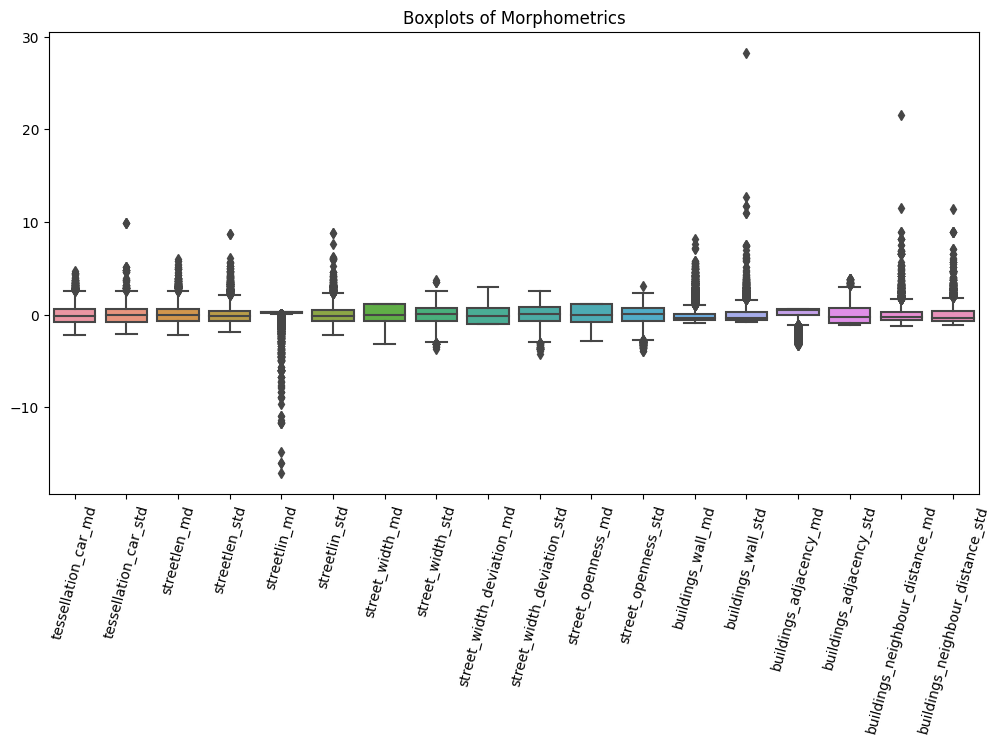

In [13]:
# Standardising the data
columns_to_normalize = df.columns[12:30]
scaler = StandardScaler()
df[columns_to_normalize] = scaler.fit_transform(df[columns_to_normalize])

# Show boxplot
columns_to_plot = df.columns[12:30]

plt.figure(figsize=(12, 6))
sns.boxplot(data=df[columns_to_plot])
plt.title('Boxplots of Morphometrics')
plt.xticks(rotation=75)
plt.show()

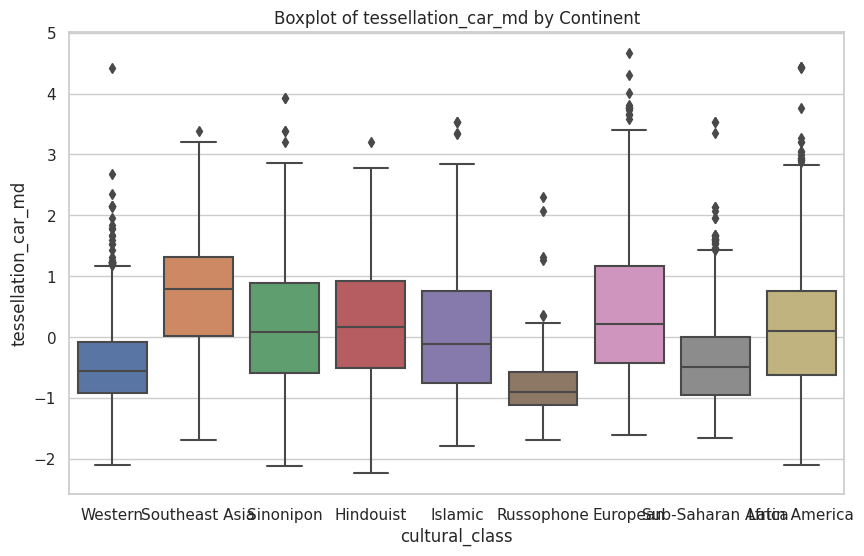

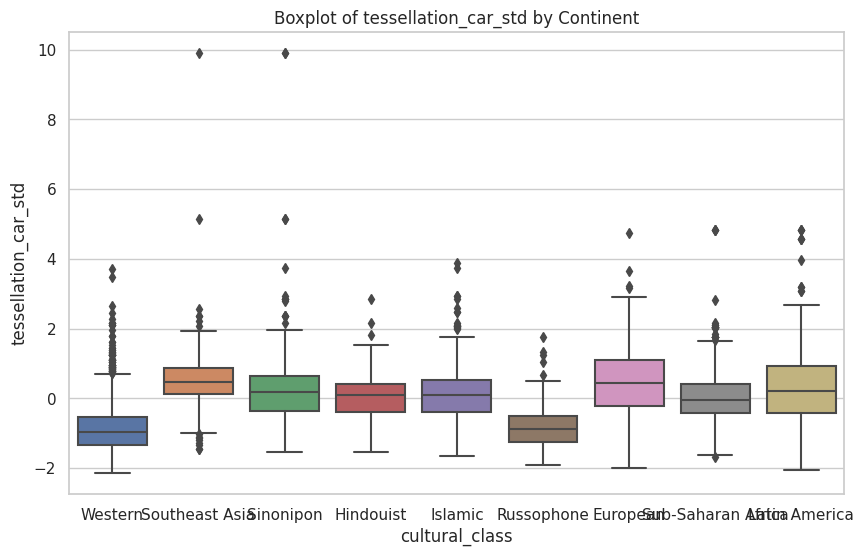

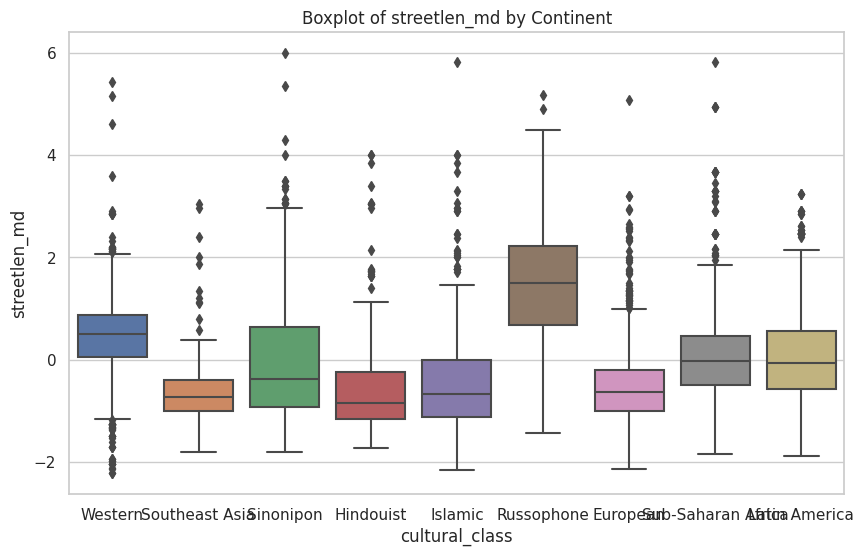

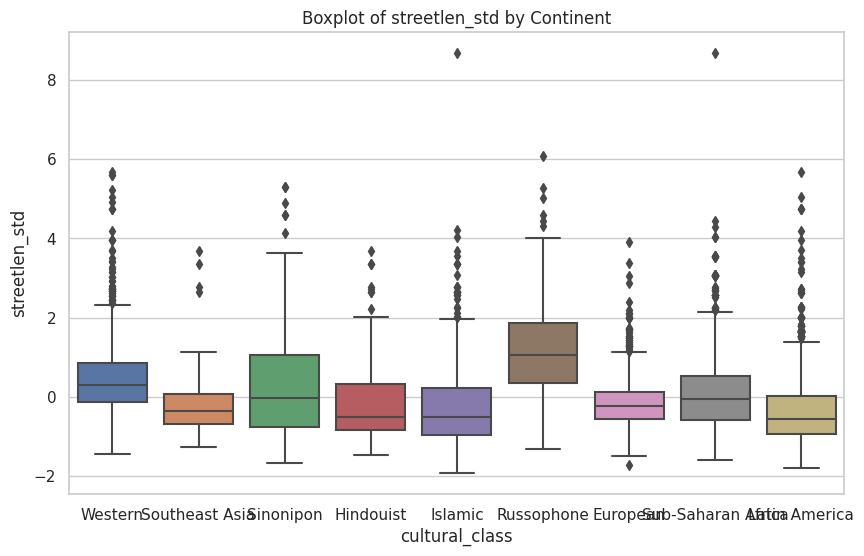

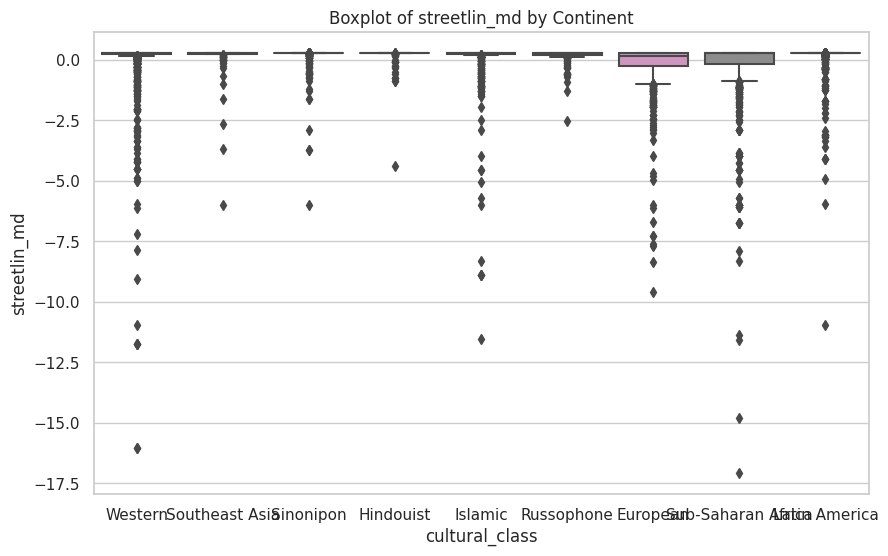

...

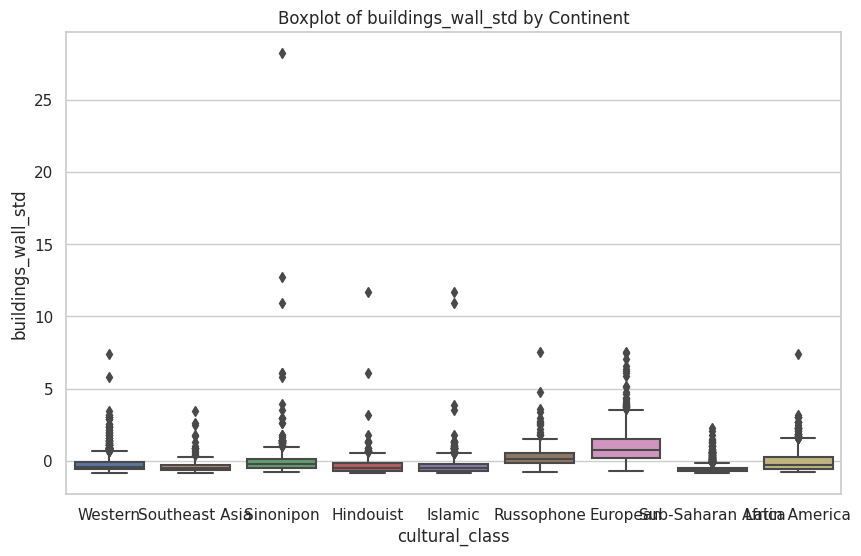

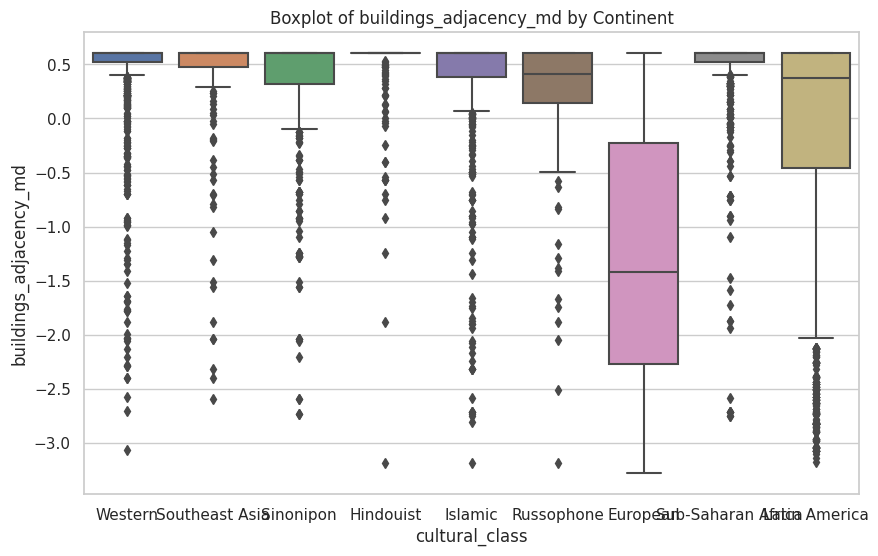

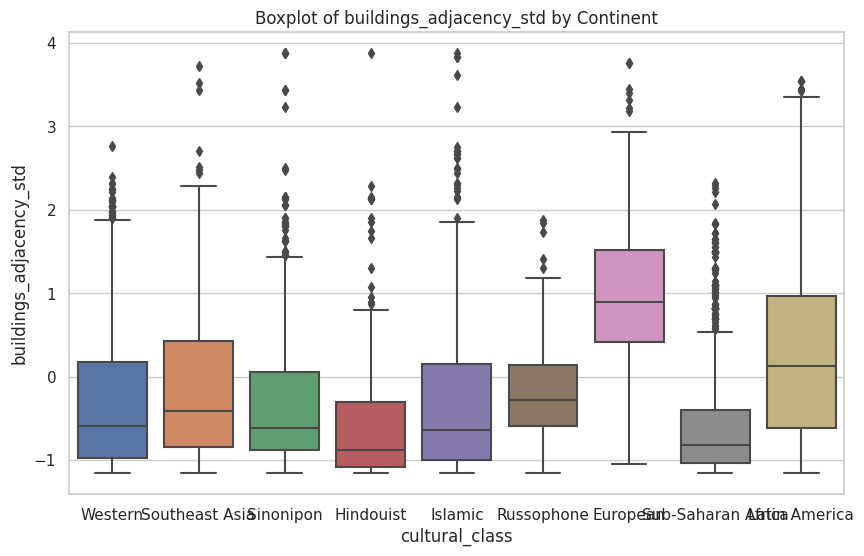

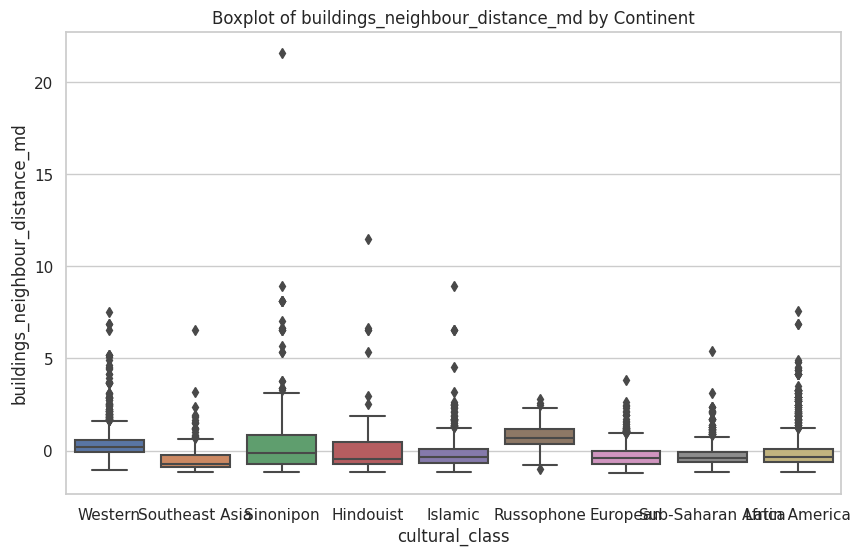

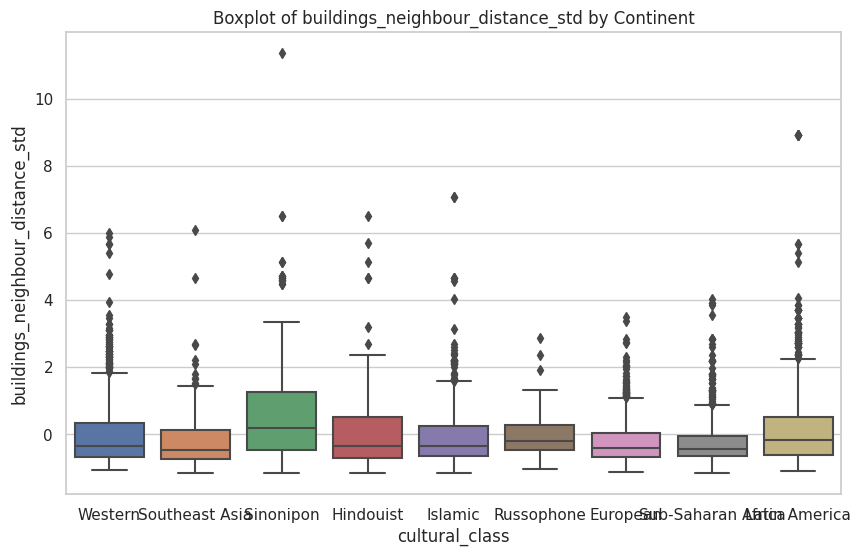

In [14]:
# Boxplots by classes
sns.set(style="whitegrid")
columns_to_plot = df.columns[12:30]

for column in columns_to_plot:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='cultural_class', y=column, data=df)
    plt.title(f'Boxplot of {column} by Continent')
    plt.show()

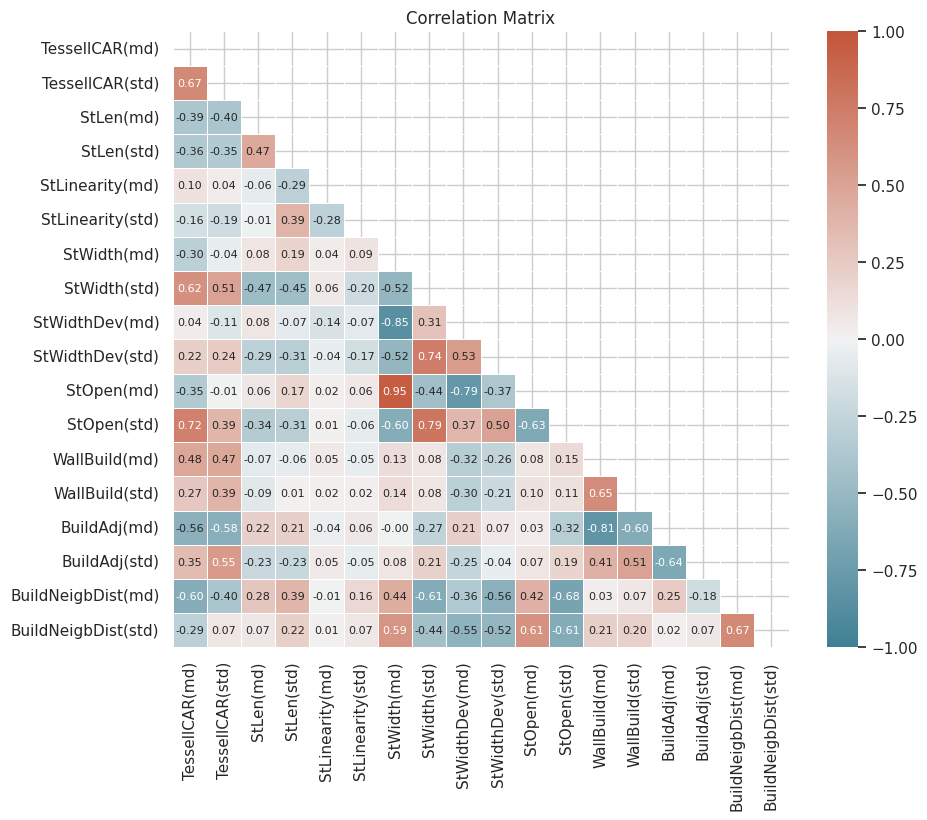

In [15]:
custom_labels = ['TessellCAR(md)', 'TessellCAR(std)', 'StLen(md)', 'StLen(std)', 'StLinearity(md)','StLinearity(std)',
                 'StWidth(md)','StWidth(std)','StWidthDev(md)','StWidthDev(std)','StOpen(md)','StOpen(std)',
                 'WallBuild(md)','WallBuild(std)','BuildAdj(md)','BuildAdj(std)','BuildNeigbDist(md)','BuildNeigbDist(std)']

# Correlation Matrix
correlation_matrix = df[df.columns[12:30]].corr()

mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

plt.figure(figsize=(10, 8))
cmap = sns.diverging_palette(220, 20, as_cmap=True)

sns.heatmap(correlation_matrix, mask=mask, cmap=cmap, fmt='.2f', linewidths=.5, square=True, vmin=-1, vmax=1,
            xticklabels=custom_labels, yticklabels=custom_labels, annot=True, annot_kws={"size": 8})

plt.title('Correlation Matrix')
plt.savefig('correlation_matrix_heatmap.png', dpi=250,bbox_inches='tight')
plt.show()

In [16]:
# Mapping All Variables
geometry = gpd.points_from_xy(df['lng'], df['lat'])
gdf = gpd.GeoDataFrame(df, geometry=geometry, crs='EPSG:4326')

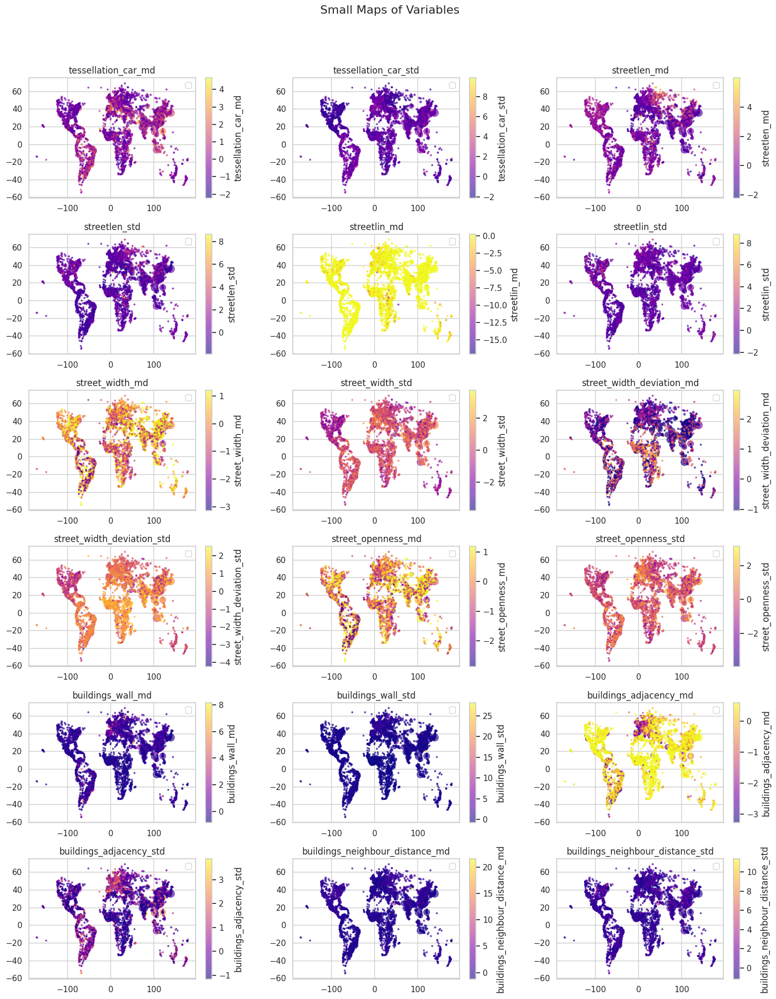

In [17]:
min_pop = gdf['population'].min()
max_pop = gdf['population'].max()
normalized_pop = (gdf['population'] - min_pop) / (max_pop - min_pop)

marker_size = 3 + 100 * normalized_pop

fig, axes = plt.subplots(nrows=6, ncols=3, figsize=(15, 20))
fig.suptitle('Small Maps of Variables', fontsize=16)

axes = axes.flatten()

for i, column in enumerate(gdf.iloc[:, 12:30].columns):
    df['marker_size'] = marker_size  # Add marker size to DataFrame for each subplot
    df.plot(ax=axes[i], kind='scatter', x='lng', y='lat', c=column, cmap='plasma', alpha=0.6, s=df['marker_size'], legend=True)
    axes[i].set_title(column)
    axes[i].set_xlabel('')
    axes[i].set_ylabel('')
    axes[i].legend()

df.drop('marker_size', axis=1, inplace=True)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])

plt.show()

## Logisitc Regression Analysis

In [36]:
# Regression analysis - Continents
X = gdf.iloc[:, 12:30]
y = gdf['continent']

model = LogisticRegression(multi_class='auto', max_iter=10000)
model.fit(X, y)

y_pred = model.predict(X)

accuracy = metrics.accuracy_score(y, y_pred)
print("Accuracy:", accuracy)

conf_matrix = metrics.confusion_matrix(y, y_pred)
print("\nConfusion Matrix:")
print(conf_matrix)

classification_report = metrics.classification_report(y, y_pred)
print("\nClassification Report:")
print(classification_report)

f1 = f1_score(y, y_pred, average='weighted')
print(f"F1 score:{f1}")

Accuracy: 0.644974912574122

Confusion Matrix:
[[ 821  201   44   91    3   95]
 [ 236  680   59  132    0  106]
 [  43   65  846  120    2   70]
 [  78   67   47 1277    2  142]
 [  14    3   11  126   10   21]
 [ 169  202  105   81    0  608]]

Classification Report:
               precision    recall  f1-score   support

       Africa       0.60      0.65      0.63      1255
         Asia       0.56      0.56      0.56      1213
       Europe       0.76      0.74      0.75      1146
North America       0.70      0.79      0.74      1613
      Oceania       0.59      0.05      0.10       185
South America       0.58      0.52      0.55      1165

     accuracy                           0.64      6577
    macro avg       0.63      0.55      0.55      6577
 weighted avg       0.64      0.64      0.64      6577

F1 score:0.6359789797944193


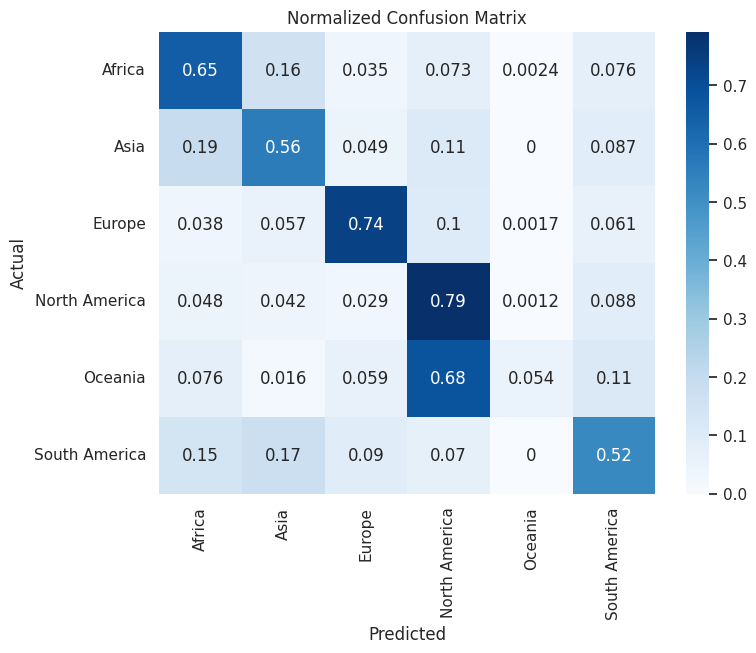

In [37]:
# Confusion matrix
cm = confusion_matrix(y, y_pred, normalize='true')

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, cmap='Blues', xticklabels=model.classes_, yticklabels=model.classes_)
plt.title('Normalized Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [38]:
# Regression analysis - Cultural classification
X = gdf.iloc[:, 12:30]
y = gdf['cultural_class']

model = LogisticRegression(multi_class='auto', max_iter=10000)
model.fit(X, y)

y_pred = model.predict(X)

accuracy = metrics.accuracy_score(y, y_pred)
print("Accuracy:", accuracy)

conf_matrix = metrics.confusion_matrix(y, y_pred)
print("\nConfusion Matrix:")
print(conf_matrix)


classification_report = metrics.classification_report(y, y_pred)
print("\nClassification Report:")
print(classification_report)

f1 = f1_score(y, y_pred, average='weighted')
print(f"F1 score:{f1}")

Accuracy: 0.5718412650144443

Confusion Matrix:
[[ 782    0   17  148    7   12    0   15   23]
 [   7    0   42   48    5   48    0   24   10]
 [  45    0   71  191    3   79    0  219   28]
 [ 112    0   19 1119    0   74    0  108  301]
 [  17    0    1   46   55    8    0    9   45]
 [  27    0   50  180    5  253    0   40   37]
 [   4    0   19   91    2   36    0   18    6]
 [  20    0   35  161    4   41    0  544   37]
 [  24    0    2  223    2   24    0   17  937]]


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Classification Report:
                    precision    recall  f1-score   support

          European       0.75      0.78      0.77      1004
         Hindouist       0.00      0.00      0.00       184
           Islamic       0.28      0.11      0.16       636
     Latin America       0.51      0.65      0.57      1733
        Russophone       0.66      0.30      0.42       181
         Sinonipon       0.44      0.43      0.43       592
    Southeast Asia       0.00      0.00      0.00       176
Sub-Saharan Africa       0.55      0.65      0.59       842
           Western       0.66      0.76      0.71      1229

          accuracy                           0.57      6577
         macro avg       0.43      0.41      0.40      6577
      weighted avg       0.53      0.57      0.54      6577

F1 score:0.5403374357971943


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


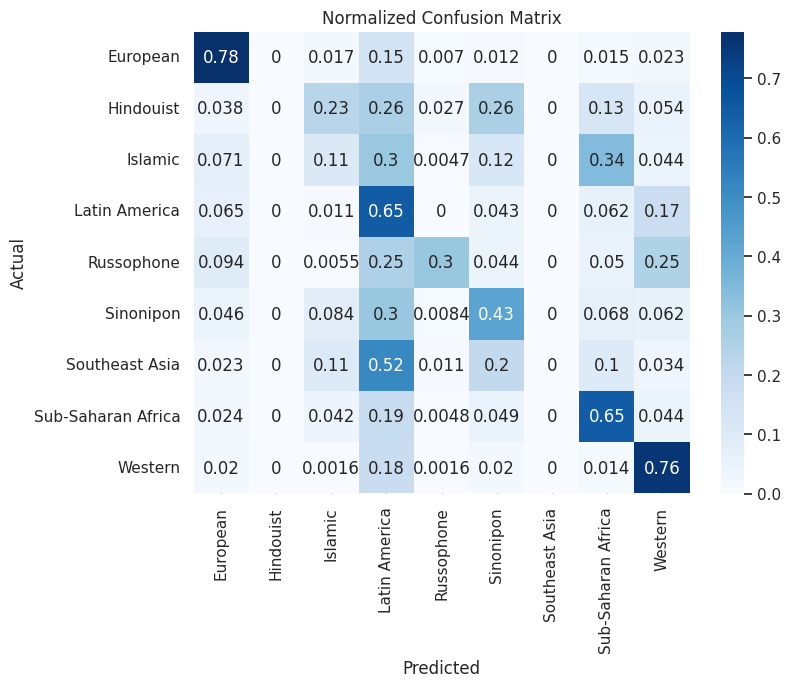

In [39]:
# Confusion matrix
cm = confusion_matrix(y, y_pred, normalize='true')  # Normalize the confusion matrix

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, cmap='Blues', xticklabels=model.classes_, yticklabels=model.classes_)
plt.title('Normalized Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# PCA

In [23]:
selected_columns = df.iloc[:, 12:30]
n_components = min(selected_columns.shape[0], selected_columns.shape[1])  # Number of components can't be more than min(rows, columns)
pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(selected_columns)

columns_pca = [f'PC{i+1}' for i in range(n_components)]
df_pca = pd.DataFrame(data=principal_components, columns=columns_pca)

df = pd.concat([df, df_pca], axis=1)

In [40]:
explained_variance_ratios = pca.explained_variance_ratio_

cumulative_explained_variance = explained_variance_ratios.cumsum()
for i, cumulative_ratio in enumerate(cumulative_explained_variance):
    print(f'Cumulative Explained Variance with {i+1}: {cumulative_ratio:.4f}')

Cumulative Explained Variance with 1: 0.3264
Cumulative Explained Variance with 2: 0.5518
Cumulative Explained Variance with 3: 0.6469
Cumulative Explained Variance with 4: 0.7172
Cumulative Explained Variance with 5: 0.7639
Cumulative Explained Variance with 6: 0.8089
Cumulative Explained Variance with 7: 0.8467
Cumulative Explained Variance with 8: 0.8808
Cumulative Explained Variance with 9: 0.9090
Cumulative Explained Variance with 10: 0.9314
Cumulative Explained Variance with 11: 0.9497
Cumulative Explained Variance with 12: 0.9676
Cumulative Explained Variance with 13: 0.9767
Cumulative Explained Variance with 14: 0.9836
Cumulative Explained Variance with 15: 0.9898
Cumulative Explained Variance with 16: 0.9951
Cumulative Explained Variance with 17: 0.9987
Cumulative Explained Variance with 18: 1.0000


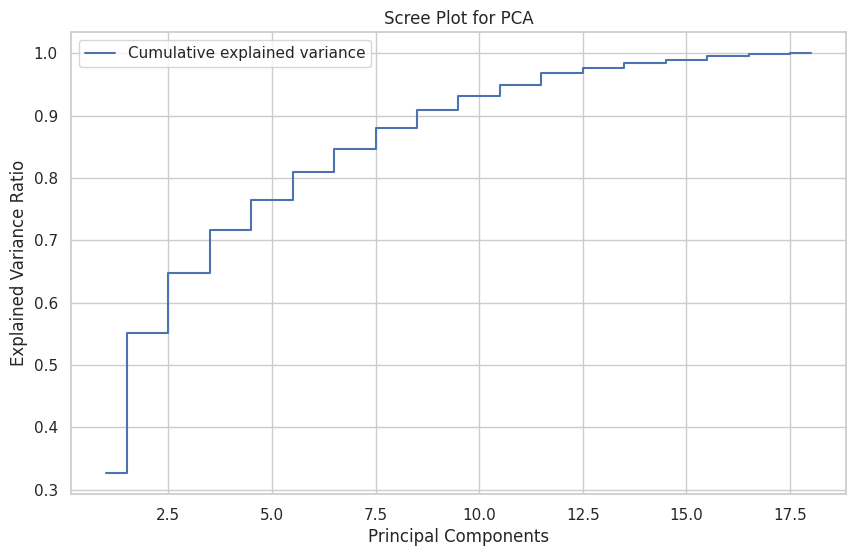

In [42]:
plt.figure(figsize=(10, 6))
plt.step(range(1, n_components + 1), np.cumsum(pca.explained_variance_ratio_), where='mid', label='Cumulative explained variance')
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance Ratio')
plt.title('Scree Plot for PCA')
plt.legend()
plt.show()

# K-means Clustering

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

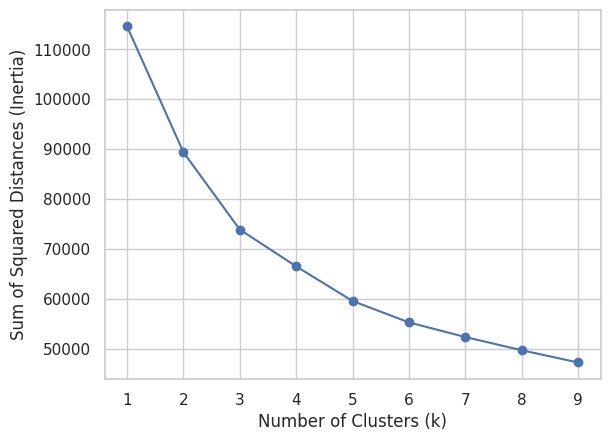

In [43]:
inertia_values = []
possible_k_values = range(1, 10)

selected_components = df_pca.iloc[:, :12]

for k in possible_k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(selected_components)
    inertia_values.append(kmeans.inertia_)

# Plot the elbow plot
plt.plot(possible_k_values, inertia_values, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Sum of Squared Distances')
plt.show()

In [44]:
n_clusters = 3

# Perform KMeans clustering
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
gdf['Cluster'] = kmeans.fit_predict(selected_components)

print(gdf['Cluster'].value_counts())

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


2    2808
0    2657
1    1112
Name: Cluster, dtype: int64


### Identifying the most representative cities per clusters

In [45]:
cluster_centers = kmeans.cluster_centers_
labels = kmeans.labels_

distances = cdist(selected_components, cluster_centers, 'euclidean')
closest_points = np.argsort(distances, axis=0)[:2, :] # 2 most representative cities

for cluster in range(n_clusters):
    print(gdf.iloc[closest_points[:, cluster]][['city','country','lat','lng','Cluster']])

                city  country      lat       lng  Cluster
3249       Rovaniemi  Finland  66.5000   25.7333        0
7215  Port Coquitlam   Canada  49.2625 -122.7811        0
          city      country        lat         lng  Cluster
4     Auckland  New Zealand -36.848463  174.764872        1
2482      Győr      Hungary  47.684200   17.634400        1
                city      country      lat       lng  Cluster
915   General Santos  Philippines   6.1167  125.1667        2
9903      Brumadinho       Brazil -20.1428  -44.2000        2


In [29]:
# make a dataframe with these to visualise them
representative_cities_df = pd.DataFrame(columns=['city', 'country', 'lat', 'lng', 'Cluster'])

for cluster in range(n_clusters):
    cluster_data = gdf.iloc[closest_points[:, cluster]][['city', 'country', 'lat', 'lng', 'Cluster']]
    representative_cities_df = pd.concat([representative_cities_df, cluster_data])

representative_cities_df.reset_index(drop=True, inplace=True)

representative_cities_df.to_csv('clusters_representative_cities_df.csv', index=False)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [30]:
# Visualise most representative cities using prettymaps
#df = pd.read_csv("/clusters_representative_cities_df.csv")

for index, row in df.iterrows():
    plot = prettymaps.plot((row['lat'], row['lng']))
    plt.savefig(f"{row['city']}_{row['country']}_cluster{row['Cluster']}.png")
    plt.close()

### Mapping the Clusters

In [31]:
# Interactive Map
import folium
map = folium.Map(location=[gdf['lat'].mean(), gdf['lng'].mean()], zoom_start=2)

# Define colors for each cluster
colors = {0: 'red', 1: 'blue', 2: 'green'}

# Iterate through the GeoDataFrame and add markers with colors based on the 'cluster' column
for row in gdf.iterrows():
    row = row[1]
    folium.CircleMarker(location=[row['lat'], row['lng']],
                       radius=5,
                       color=colors[row['Cluster']],
                       fill=True,
                       fill_color=colors[row['Cluster']],
                       fill_opacity=0.6).add_to(map)
map

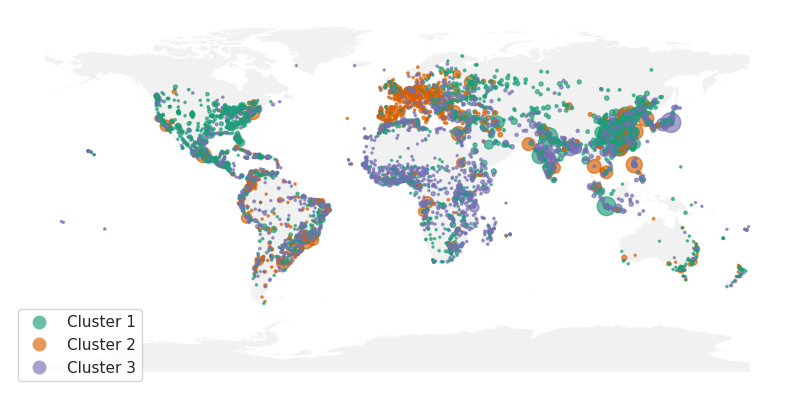

In [32]:
# Figure Map
gdf_sorted = gdf.sort_values(by='population', ascending=False)

min_pop = gdf_sorted['population'].min()
max_pop = gdf_sorted['population'].max()
normalized_pop = (gdf_sorted['population'] - min_pop) / (max_pop - min_pop)
marker_size = 2 + 200 * normalized_pop

fig, ax = plt.subplots(figsize=(10, 6))
cmap = matplotlib.colors.ListedColormap(["#1b9e77","#d95f02","#7570b3"], name='from_list', N=None)

world_continents.plot(ax=ax, color='lightgray', edgecolor='none', alpha=0.3)

# Plot points colored by cluster and sized by marker_size
gdf_sorted.plot(ax=ax, s=marker_size, column='Cluster', legend=True, cmap=cmap, categorical=True, alpha=0.65, legend_kwds={'loc': 'lower left'})

legend = ax.get_legend()

for label in legend.get_texts():
    cluster_number = int(label.get_text()) + 1
    label.set_text(f'Cluster {cluster_number}')

ax.set_axis_off()

# Add title and show the plot
plt.savefig('map_clusters_of_cities.png', dpi=250, bbox_inches='tight')
plt.show()

In [33]:
# normalise minmax to show differences of variables by cluster
columns_to_normalize = gdf.columns[12:30]
scaler = MinMaxScaler()
gdf[columns_to_normalize] = scaler.fit_transform(gdf[columns_to_normalize])

selected_columns = gdf.iloc[:, 12:30]
cluster_column = gdf['Cluster']
data_for_plotting = pd.concat([selected_columns, cluster_column], axis=1)
data_for_plotting

,tessellation_car_md,tessellation_car_std,streetlen_md,streetlen_std,streetlin_md,streetlin_std,street_width_md,street_width_std,street_width_deviation_md,street_width_deviation_std,street_openness_md,street_openness_std,buildings_wall_md,buildings_wall_std,buildings_adjacency_md,buildings_adjacency_std,buildings_neighbour_distance_md,buildings_neighbour_distance_std,Cluster
0,0.606722,0.466826,0.214147,0.373589,0.985703,0.241497,0.638895,0.559175,0.271264,0.642403,0.571906,0.682165,0.281863,0.058836,0.451850,0.434792,0.037162,0.090948,1
1,0.710875,0.256440,0.084316,0.114554,0.999892,0.108081,1.000000,0.513566,0.000000,0.859692,1.000000,0.798894,0.384863,0.102389,0.296188,0.405834,0.030340,0.050992,1
2,0.531229,0.351665,0.182825,0.217452,0.983577,0.197622,0.862874,0.481563,0.075311,0.618484,0.811594,0.639388,0.235642,0.077225,0.554329,0.535987,0.046812,0.146795,1
3,0.633530,0.485239,0.149441,0.193668,0.998738,0.184531,0.960143,0.463520,0.002120,0.598148,0.917874,0.646491,0.307896,0.096953,0.407721,0.434694,0.038539,0.070810,1
4,0.482222,0.305433,0.189954,0.138402,0.978489,0.186733,0.706057,0.527794,0.219566,0.545302,0.555239,0.694241,0.241768,0.077979,0.529570,0.441051,0.045173,0.069288,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10178,0.160584,0.141832,0.214037,0.136192,1.000000,0.246799,0.974050,0.443938,0.000000,0.715080,0.965600,0.376075,0.038342,0.018644,0.943548,0.183990,0.074169,0.144924,0
10179,0.528419,0.215577,0.143653,0.117211,1.000000,0.161875,0.249244,0.597943,0.609780,0.662211,0.130435,0.694617,0.018441,0.002285,1.000000,0.014932,0.011819,0.031826,2
10180,0.528419,0.215577,0.143653,0.117211,1.000000,0.161875,0.249244,0.597943,0.609780,0.662211,0.130435,0.694617,0.018441,0.002285,1.000000,0.014932,0.011819,0.031826,2
10184,0.360933,0.191971,0.431114,0.066189,1.000000,0.082322,1.000000,0.390289,0.000000,0.565919,1.000000,0.538504,0.086131,0.036377,0.674502,0.336747,0.035377,0.092538,0


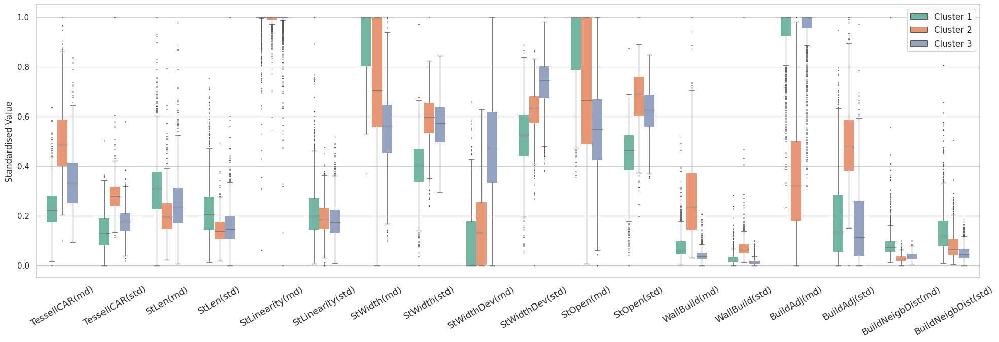

In [34]:
melted_data = pd.melt(data_for_plotting, id_vars='Cluster', var_name='Column', value_name='Value')

# Create a boxplot of variables by cluster
plt.figure(figsize=(24, 7))
sns.boxplot(x='Column', y='Value', hue='Cluster', data=melted_data, palette='Set2',
            boxprops=dict(edgecolor='none'),
            flierprops=dict(markerfacecolor='grey', markersize=0.5),
            medianprops=dict(color='grey',linewidth=1),
            whiskerprops=dict(color='grey',linewidth=1),
            capprops=dict(color='grey',linewidth=1),
            width=0.6)

custom_labels = ['TessellCAR(md)', 'TessellCAR(std)', 'StLen(md)', 'StLen(std)', 'StLinearity(md)','StLinearity(std)','StWidth(md)','StWidth(std)','StWidthDev(md)','StWidthDev(std)','StOpen(md)','StOpen(std)','WallBuild(md)','WallBuild(std)','BuildAdj(md)','BuildAdj(std)','BuildNeigbDist(md)','BuildNeigbDist(std)']

plt.xticks(ticks=range(len(custom_labels)), labels=custom_labels,rotation=30, fontsize=13)

plt.xlabel('')
plt.ylabel('Standardised Value')

plt.subplots_adjust(wspace=0.5)

legend = plt.legend(fontsize='medium')
legend_labels = legend.texts
for label in legend_labels:
    label.set_text(f'Cluster {int(label.get_text()) + 1}')


plt.savefig('boxplot_clusters.png', bbox_inches='tight', dpi=300)  # Adjust the file format and name as needed

plt.show()

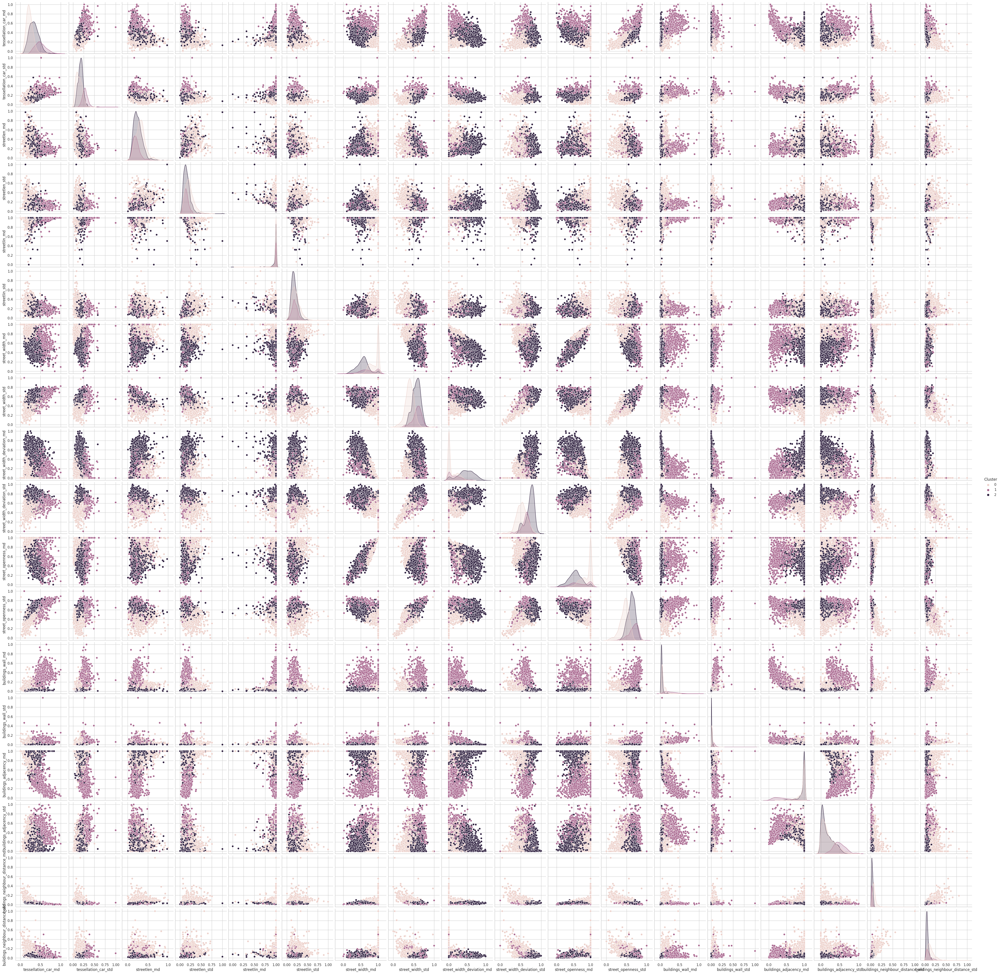

In [46]:
# show scatterplots coloured by cluster for all variables
selected_columns = gdf.iloc[:, 12:30]
custer_column = gdf['Cluster']
data_for_plotting = pd.concat([selected_columns, custer_column], axis=1)

sns.pairplot(data_for_plotting, hue='Cluster')
plt.show()